# 특징점 매칭 

두 영상에서 추출한 특징점 기술자를 비교하여 서로 비슷한 특징점을 찾는 작업

이때 추출된 특징점은 DMatch라고 부르며 다음과 같은 값을 가지고 있음

    int queryIdx : 쿼리 기술자 번호
    int trainIdx : 훈련 기술자 번호
    int imgIdx   : 훈련 영상 번호

    float distance : 두 기술자 사이의 거리


OpenCV에서는 여러 Matcher들을 지원하고 있음

# 1. BFMatcher(normType,crossChecker)

Brute-Force 매칭

## normType : 거리 측정 방식

사용가능 인자들:

+ cv2.NORM_L2   
+ cv2.NORM_L1   
+ cv2.NORM_HAMMING   
+ cv2.NORMHAMMING2   

*자신이 사용한 특징점 검출 방식에 따라 적절한 인자를 선택해야함

## crossChecker : crossChecker 사용 여부

crossChecker :이미지 A에서 B의 특징을 매칭한 후, 다시 이미지 B에서 A의 특징을 매칭하는 방법 

(Boolean)으로 입력
     
    
# 2. FlannBasedMatcher(index_params,search_params)

가장 가까운 이웃의 근사 값으로 매칭을 수행(KNN과 유사한 방식)
BF 매칭에 비해 큰 이미지에서 더욱 빠른 성능을 보여줌.


## index_params

알고리즘을 결정하는 파라미터   
아래와 같이 딕셔너리로 작성함.   

예)  index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)  

사용가능한 알고리즘   

+ FLANN_INDEX_LINEAR=0: 선형 인덱싱, BFMatcher와 동일
+ FLANN_INDEX_KDTREE=1: KD-트리 인덱싱 (trees=4: 트리 개수(16을 권장))
+ FLANN_INDEX_KMEANS=2: K-평균 트리 인덱싱 (branching=32: 트리 분기 개수 iterations=11: 반복 횟수, centers_init=0: 초기 중심점 방식)
+ FLANN_INDEX_COMPOSITE=3: KD-트리, K-평균 혼합 인덱싱 (trees=4: 트리 개수, + + branching=32: 트리 분기 새수, iterations=11: 반복 횟수, centers_init=0: 초기 중심점 방식)
+ FLANN_INDEX_LSH=6: LSH 인덱싱 (table_number: 해시 테이블 수, key_size: 키 비트 크기, multi_probe_level: 인접 버킷 검색)
+ FLANN_INDEX_AUTOTUNED=255: 자동 인덱스 (target_precision=0.9: 검색 백분율, build_weight=0.01: 속도 우선순위, memory_weight=0.0: 메모리 우선순위, sample_fraction=0.1: 샘플 비율)

## search_params

검색 파라미터, 역시 딕셔너리로 작성함.   

예) search_params = dict(checks=50)

사용가능한 파라미터들   

+ checks : 검색할 후보들 (int)
+ eps : ???
+ sorted : 정렬해서 반환 (Boolean)


Matcher들은 객체로 선언되며, 아래 메소드들을 사용할 수 있음.

# match(query,target,mask)
1개의 최적 매칭을 반환. 결과로 DMatch 객체의 리스트를 전달함.

## query
+ 특징 디스크립터 배열, 매칭의 기준

## target
+ 특징 디스크립터 배열, 매칭의 대상

## mask
+ 매칭 진행 여부

# knnMatch(query,target,k,mask,compactResult)

k개의 가장 근접한 매칭을 반환. 결과로 DMatch 객체의 리스트를 전달함.

## k

+ 매칭할 근접 이웃 개수

## compactResult

+ 만약 해당하는 매칭이 없을 경우, 매칭 결과에 불포함할지 여부

# radiusMatch(query,target,maxDistance,mask,compactResult)
maxDistance 이내의 거리 매칭. 결과로 DMatch 객체의 리스트를 전달함.

## maxDistance

+ 매칭 대상 거리

In [14]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

#SURF로 특징을 추출함.
detector = cv2.xfeatures2d.SIFT_create()

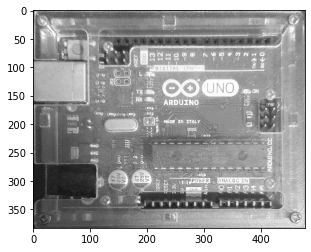

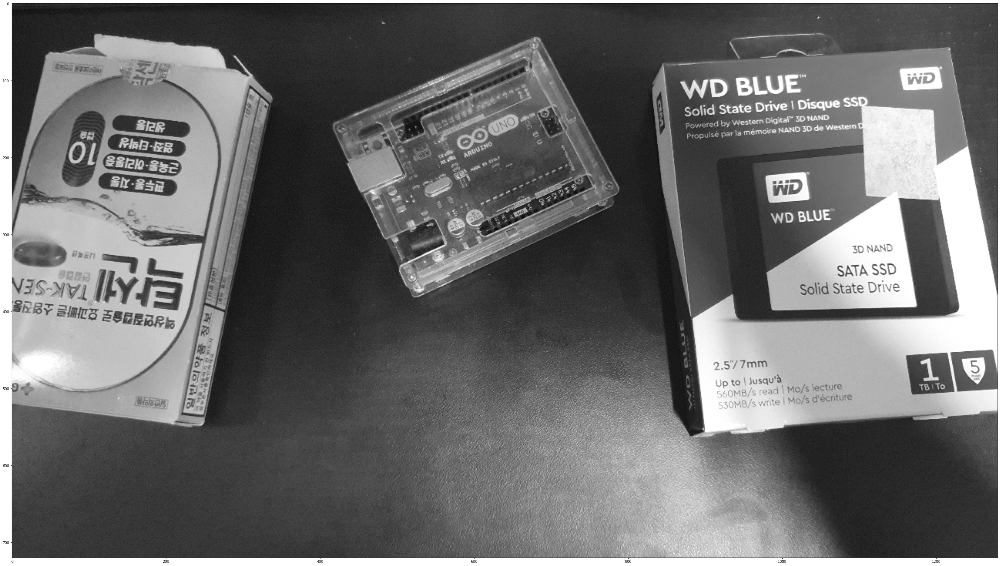

In [15]:
#찾을 이미지 그레이스케일 이미지 사용
goal = cv2.imread('./img/matcher/goal.PNG',cv2.IMREAD_GRAYSCALE)
plt.imshow(goal,cmap='gray')
#찾을 대상 이미지 그레이스케일 이미지 사용
target = cv2.imread('./img/matcher/target.jpg',cv2.IMREAD_GRAYSCALE)
plt.figure(figsize=(50,50))
plt.imshow(target,cmap='gray')

In [16]:
#특징점 검출
kp1,desc1 = detector.detectAndCompute(goal,None)
kp2,desc2 = detector.detectAndCompute(target,None)

# BFMatcher

## match()

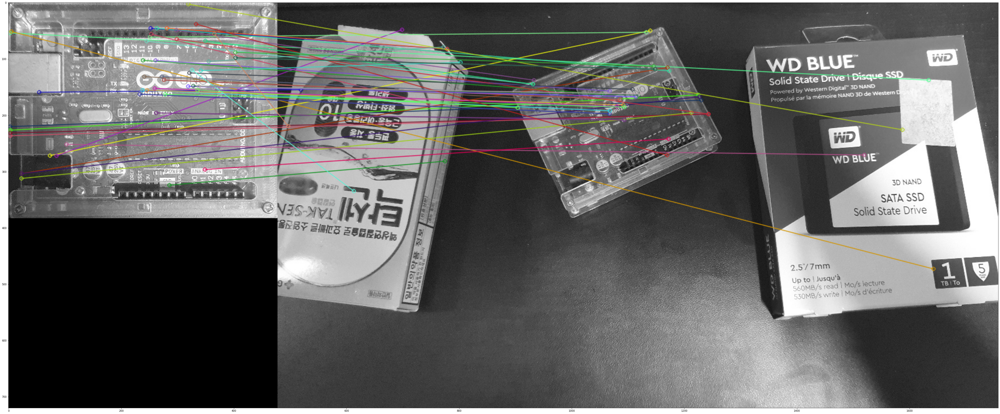

In [30]:
#BFMatcher / match
matcher = cv2.BFMatcher()
matches = matcher.match(desc1,desc2)

#최소 최대 거리를 구해줌
min_distance = min([matches[i].distance for i in range(len(matches))])
max_distance = max([matches[i].distance for i in range(len(matches))])

# 임계점 설정 - 이 코드는 최소 거리의 15%로 설정함.
thresh = (max_distance - min_distance) * 0.2 + min_distance

#goodmaches만 걸러냄
good = []
for m in matches:
    if m.distance < thresh:
        good.append(m)

#cv2.drawMatches로 그려줌
match = cv2.drawMatches(goal,kp1,target,kp2,good,None,flags=2) 
plt.figure(figsize=(70,70))
plt.imshow(match)

## knnMatch()

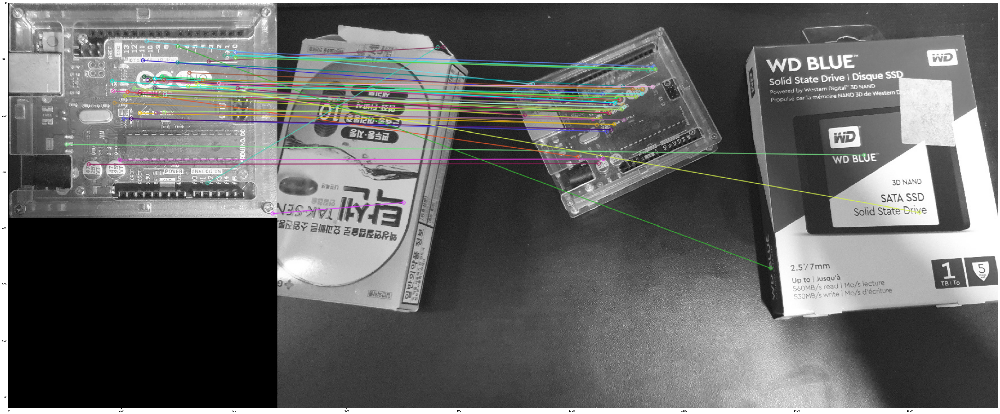

In [19]:
#BFMatcher - Knn
matcher = cv2.BFMatcher()
matches = matcher.knnMatch(desc1,desc2,k=2)

#첫번재 이웃의 거리가 두 번째 이웃 거리의 75% 이내
good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

#cv2.drawMatchesKnn로 그려줌
knn_match = cv2.drawMatchesKnn(goal,kp1,target,kp2,good,None,flags=2) 
plt.figure(figsize=(70,70))
plt.imshow(knn_match)

# FlannBasedMatche

## match()

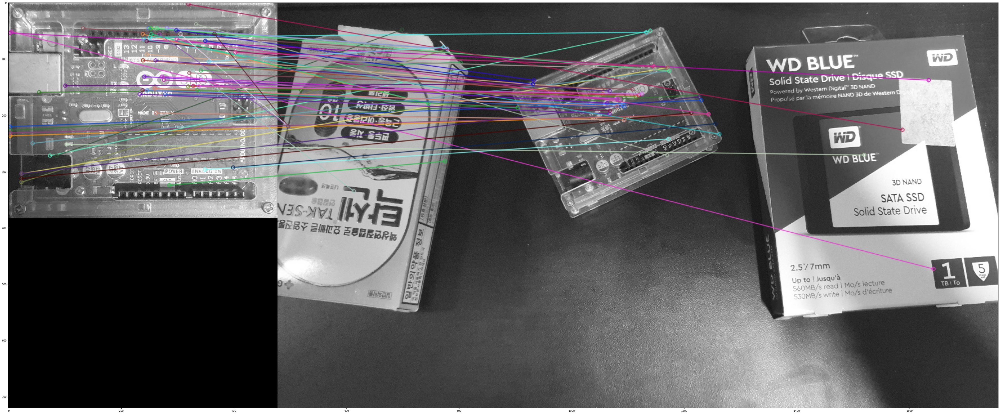

In [32]:
#FlannBasedMatche

FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)

#객체 생성
matcher = cv2.FlannBasedMatcher(index_params,search_params)

#Match 실행
matches = matcher.match(desc1,desc2)

#최소 최대 거리를 구해줌
min_distance = min([matches[i].distance for i in range(len(matches))])
max_distance = max([matches[i].distance for i in range(len(matches))])

# 임계점 설정 - 이 코드는 최소 거리의 15%로 설정함.
thresh = (max_distance - min_distance) * 0.2 + min_distance

#goodmaches만 걸러냄
good = []
for m in matches:
    if m.distance < thresh:
        good.append(m)
        
#cv2.drawMatchesKnn로 그려줌     
match = cv2.drawMatches(goal,kp1,target,kp2,good,None,flags=2) 
plt.figure(figsize=(70,70))
plt.imshow(match)

## knnMatch()

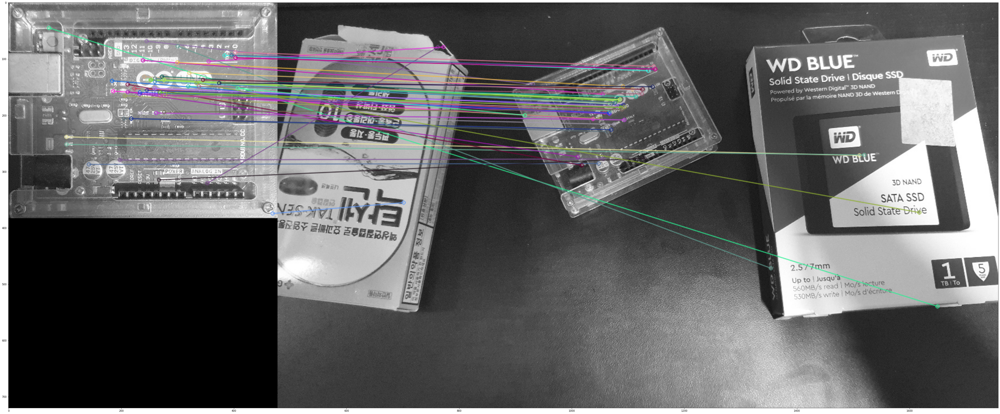

In [33]:
#FlannBasedMatche - knnMatch

FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)

#객체 생성
matcher = cv2.FlannBasedMatcher(index_params,search_params)
#knnMatch 실행
matches = matcher.knnMatch(desc1,desc2,k=2)

#첫번재 이웃의 거리가 두 번째 이웃 거리의 75% 이내
good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

#cv2.drawMatchesKnn로 그려줌
knn_match = cv2.drawMatchesKnn(goal,kp1,target,kp2,good,None,flags=2) 
plt.figure(figsize=(70,70))
plt.imshow(knn_match)

|BFMatch / Match|FLANN / Match|
|---|---|
|![img](https://github.com/hrabit64/ERICA-2021-FALL-OPENCV-STUDY/blob/master/week4/img/matcher/bf-match.png?raw=true)|![img](https://github.com/hrabit64/ERICA-2021-FALL-OPENCV-STUDY/blob/master/week4/img/matcher/flan-match.png?raw=true)|

|BFMatch / Knn|FLANN / Knn|
|---|---|
|![img](https://github.com/hrabit64/ERICA-2021-FALL-OPENCV-STUDY/blob/master/week4/img/matcher/bf-knn.png?raw=true)|![img](https://github.com/hrabit64/ERICA-2021-FALL-OPENCV-STUDY/blob/master/week4/img/matcher/flan-knn.png?raw=true)|